## Import all needed libraries

In [1]:
import tensorflow as tf
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import warnings
from tqdm.notebook import tqdm
import os
import PIL
from tensorflow import keras
from tensorflow.keras import layers
from keras.layers import *
from keras.models import Sequential, Model
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
import matplotlib.pyplot as plt
import time
from keras.preprocessing.image import ImageDataGenerator
import glob
import cv2
from IPython import display

warnings.filterwarnings('ignore')

## Load data

In [2]:
image_dir = '/kaggle/input/anime-faces/data/'
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(image_dir):
    image_path = os.path.join(image_dir, image_name)
    image_paths.append(image_path)

## Remove unnecessary file

In [3]:
# remove unnecessary file
image_paths.remove('/kaggle/input/anime-faces/data/data')

In [4]:
print(len(image_paths))

21551


## Display anime face images in dataset

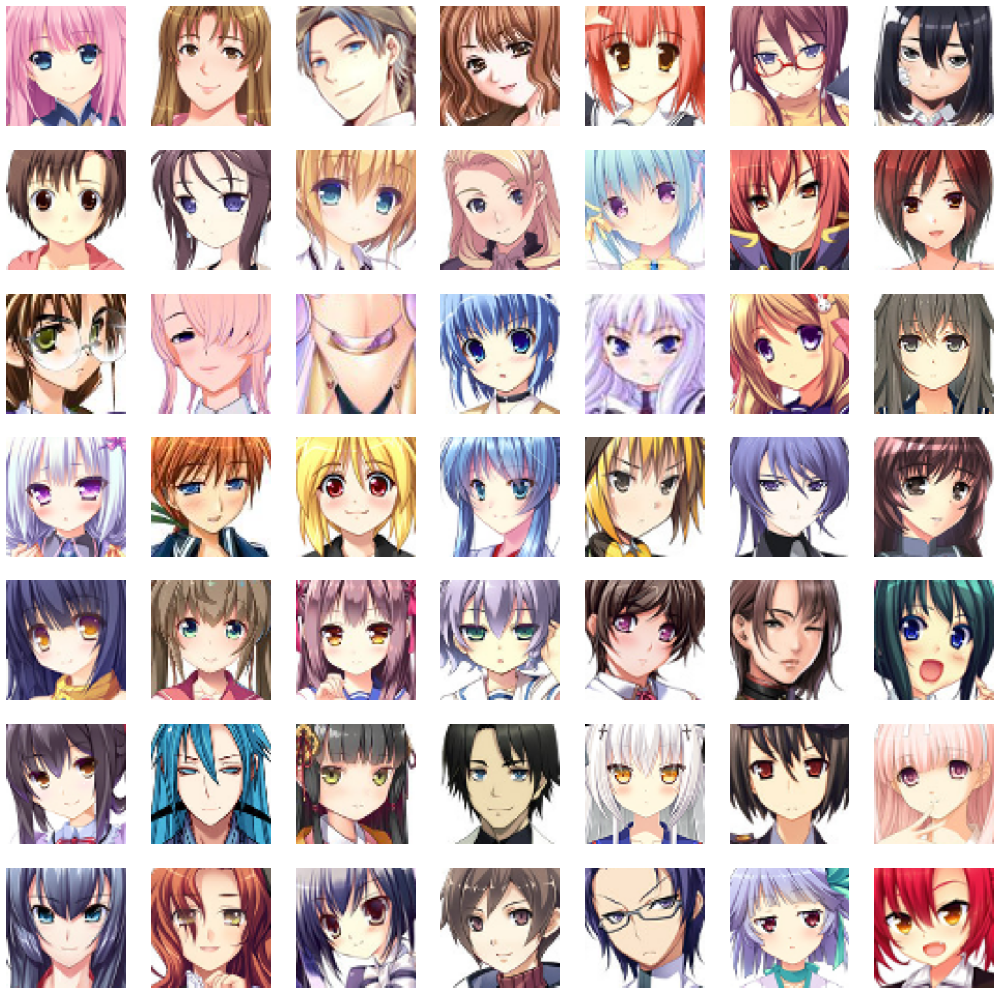

In [5]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[20:69]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Load the image and convert into numpy array

In [6]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [7]:
train_images[0].shape

(64, 64, 3)

## Reshape the array into [-1,1]

In [8]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64,3).astype('float32')
# Normalize the images to [-1, 1]
train_images = (train_images - 127.5) / 127.5

## Buffer size and batch size

In [9]:
BUFFER_SIZE = 60000
BATCH_SIZE = 16

## Batch and shuffle the data

In [10]:
# Batch and shuffle the data
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

## Generator model

In [11]:
def make_generator_model():
    model = Sequential()

    # 1d random noise
    model.add(layers.Dense(8 * 8 * 512, input_dim=100))
    # model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    # convert 1d to 3d
    model.add(layers.Reshape((8, 8, 512)))

    # upsample to 16x16
    model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)))
    # model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    # upsample to 32x32
    model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)))
    # model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    # upsample to 64x64
    model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=tf.keras.initializers.RandomNormal(mean=0.0, stddev=0.02)))
    # model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    model.add(layers.Conv2D(3, (4, 4), padding='same', activation='tanh'))

    generator = model
    generator.summary()
    return generator

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 16, 16, 256)      2097408   
 nspose)                                                         
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2DT  (None, 32, 32, 128)      524416    
 ranspose)                                              

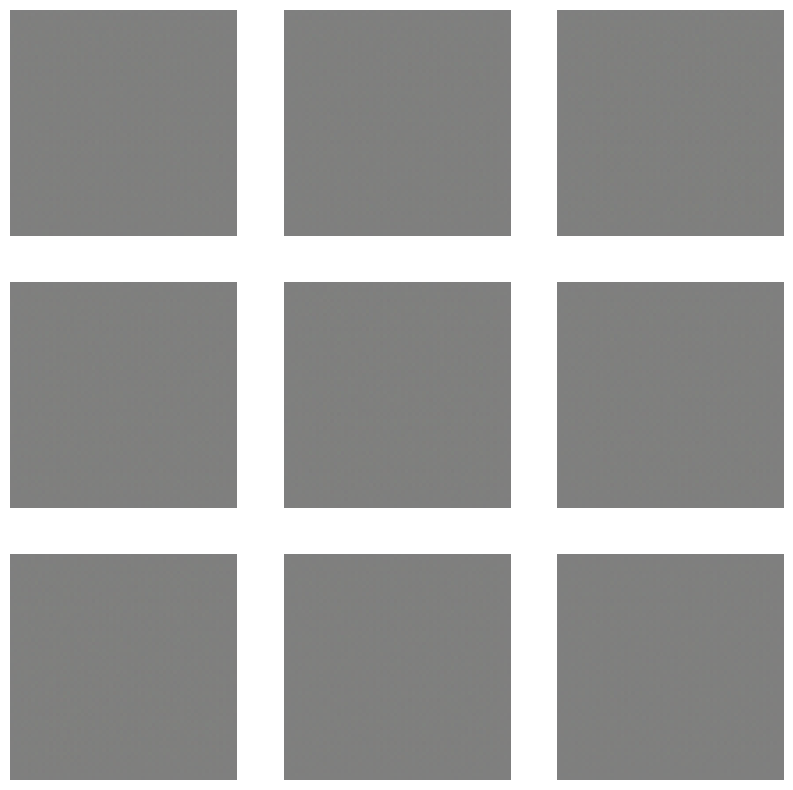

In [12]:
generator = make_generator_model()

noise = tf.random.normal([16, 100])
generated_images = generator(noise, training=False)

# Rescale pixel values from [-1, 1] to [0, 255] and convert to uint8
generated_images = ((generated_images + 1) * 127.5).numpy().astype('uint8')

# Plot generated images
fig, ax = plt.subplots(nrows=3, ncols=3, figsize=(10, 10))
for i, axi in enumerate(ax.flat):
    axi.imshow(generated_images[i])
    axi.axis('off')
plt.show()

## Discriminator model

In [13]:
def make_discriminator_model():
    model = Sequential()
    input_shape = (64, 64, 3)
    alpha = 0.2

    # create conv layers
    model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=alpha))

    model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=alpha))

    model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=alpha))

    model.add(layers.Flatten())
    model.add(layers.Dropout(0.3))

    # output class
    model.add(layers.Dense(1, activation='sigmoid'))

    discriminator = model
    discriminator.summary()
    return discriminator

In [14]:
discriminator = make_discriminator_model()
decision = discriminator(generated_images)
print (decision)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (BatchN  (None, 32, 32, 64)       256       
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)      

## DCGAN model

In [15]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        
    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]
    
    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn
        
    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))
        
        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)
            
            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)
            
            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2
            
        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))
        
        
        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)
            
        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))
        
        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)
        
        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

## Plot losses function and DCGAN Monitor

In [16]:
def plot_losses(g_losses, d_losses):
    plt.plot(g_losses, label='Generator Loss')
    plt.plot(d_losses, label='Discriminator Loss')
    plt.title('Generator and Discriminator Losses')
    plt.legend()
    plt.show()

class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])
        self.g_losses = []
        self.d_losses = []

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()
        
        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()
        self.g_losses.append(logs['g_loss'])
        self.d_losses.append(logs['d_loss'])
        
        if epoch == 50:
            plt.figure()
            plt.plot(range(1, 51), self.g_losses, label='Generator Loss')
            plt.plot(range(1, 51), self.d_losses, label='Discriminator Loss')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.legend()
            plt.show()
        
    def on_train_end(self, logs=None):
        self.model.generator.save('dcgan.h5')
        plot_losses(self.g_losses, self.d_losses)

## Initialize DCGAN

In [17]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=100)

## Compile DCGAN with Adam optimizer

In [18]:
D_LR = 0.0001 
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

## Training

Epoch 1/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6638 - g_loss: 2.7027

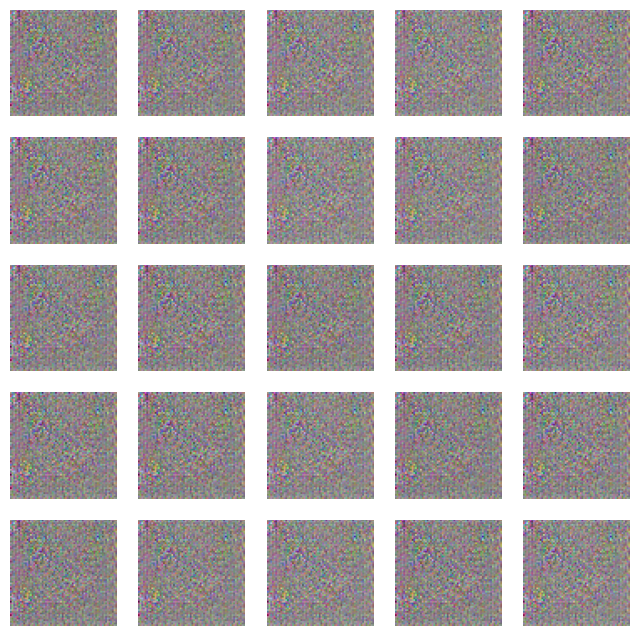

674/674 [==============================] - 35s 42ms/step - d_loss: 0.6638 - g_loss: 2.7027
Epoch 2/50
674/674 [==============================] - ETA: 0s - d_loss: 0.4456 - g_loss: 2.3567

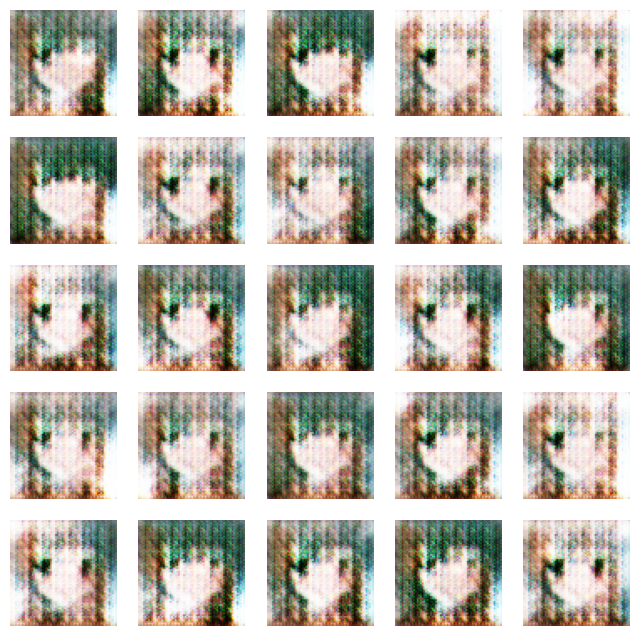

674/674 [==============================] - 28s 42ms/step - d_loss: 0.4456 - g_loss: 2.3567
Epoch 3/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5798 - g_loss: 1.7399

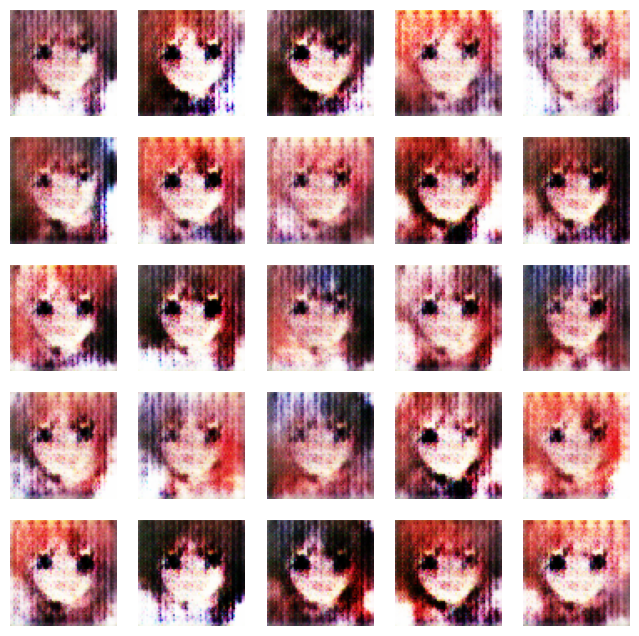

674/674 [==============================] - 29s 43ms/step - d_loss: 0.5799 - g_loss: 1.7394
Epoch 4/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5981 - g_loss: 1.7313

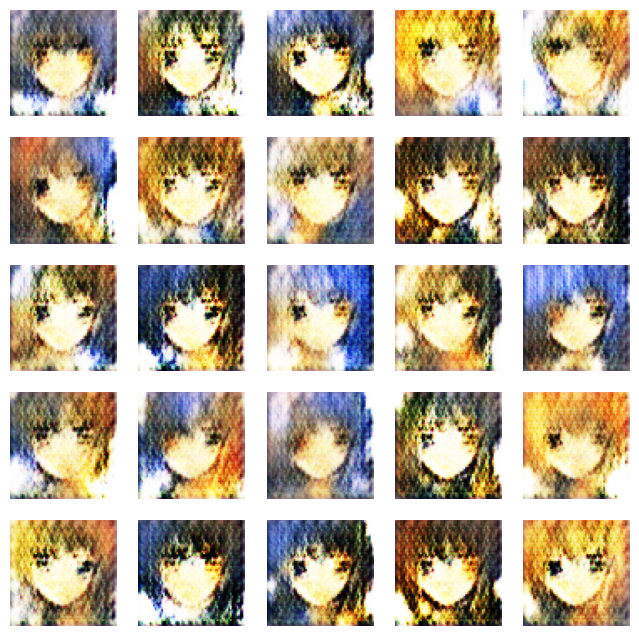

674/674 [==============================] - 28s 42ms/step - d_loss: 0.5979 - g_loss: 1.7316
Epoch 5/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6280 - g_loss: 1.5938

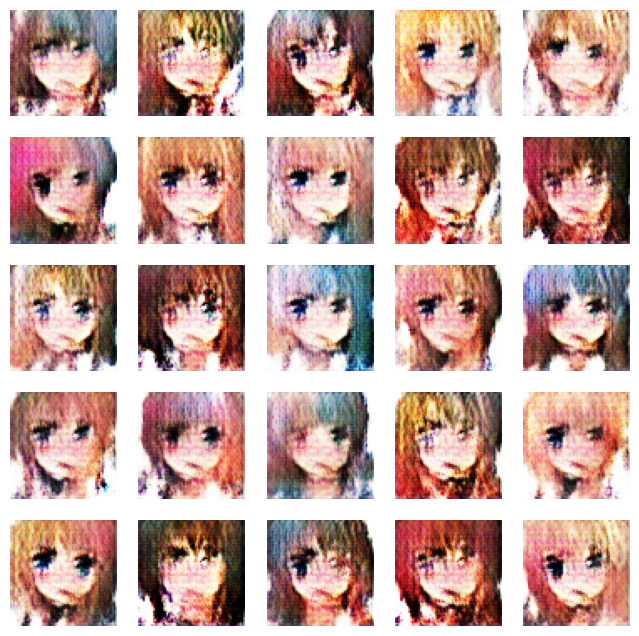

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6282 - g_loss: 1.5932
Epoch 6/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6133 - g_loss: 1.5371

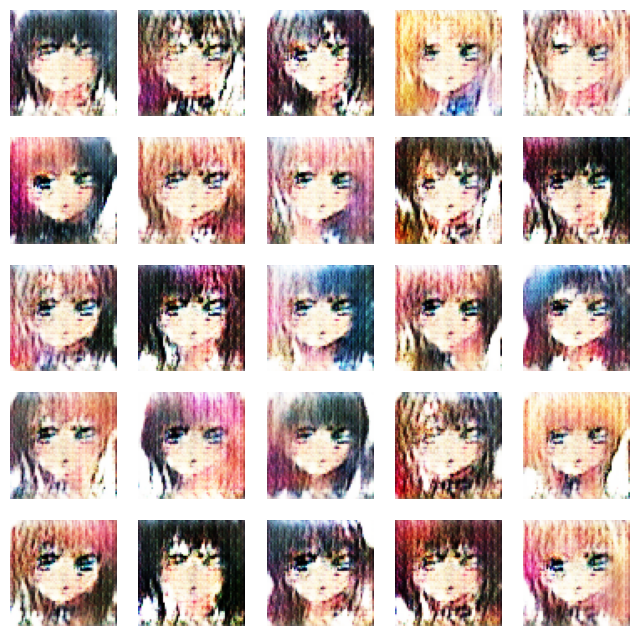

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6133 - g_loss: 1.5371
Epoch 7/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6191 - g_loss: 1.4671

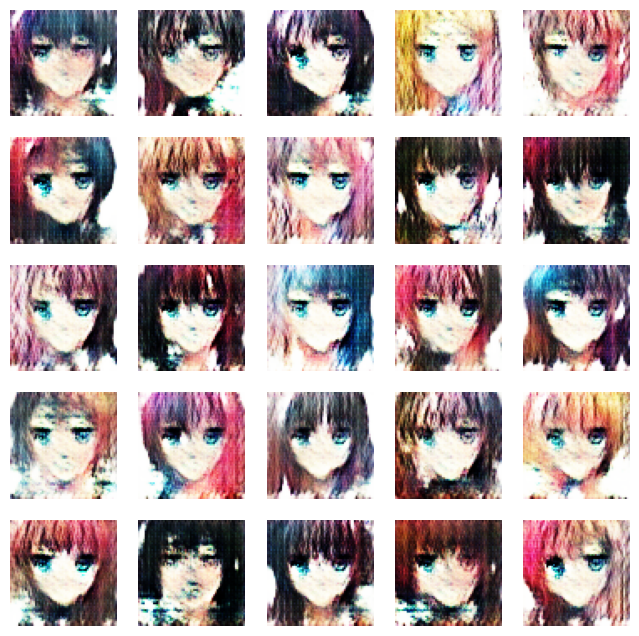

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6191 - g_loss: 1.4671
Epoch 8/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6198 - g_loss: 1.3435

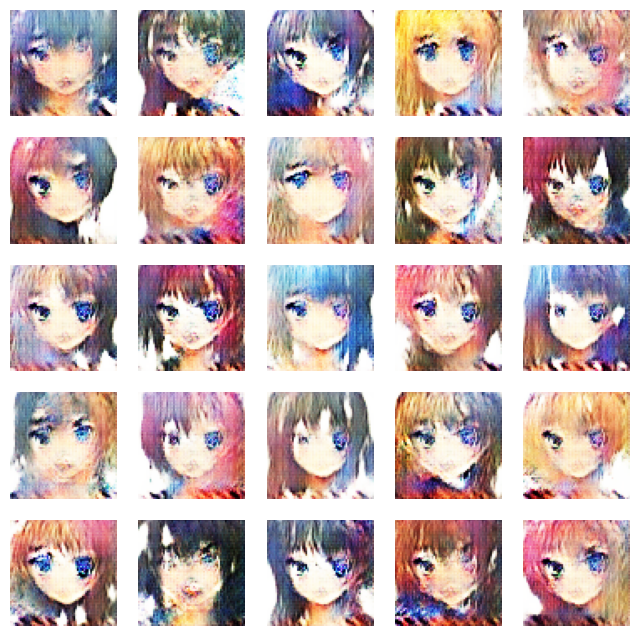

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6199 - g_loss: 1.3431
Epoch 9/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5918 - g_loss: 1.3919

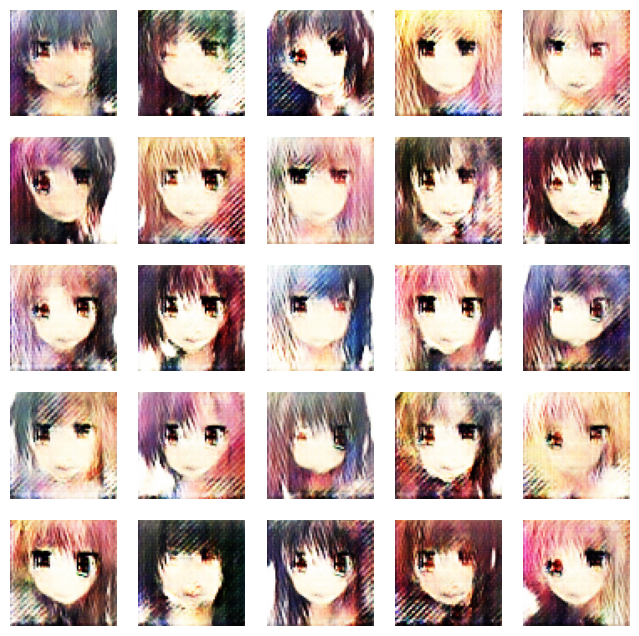

674/674 [==============================] - 29s 43ms/step - d_loss: 0.5916 - g_loss: 1.3919
Epoch 10/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5842 - g_loss: 1.3688

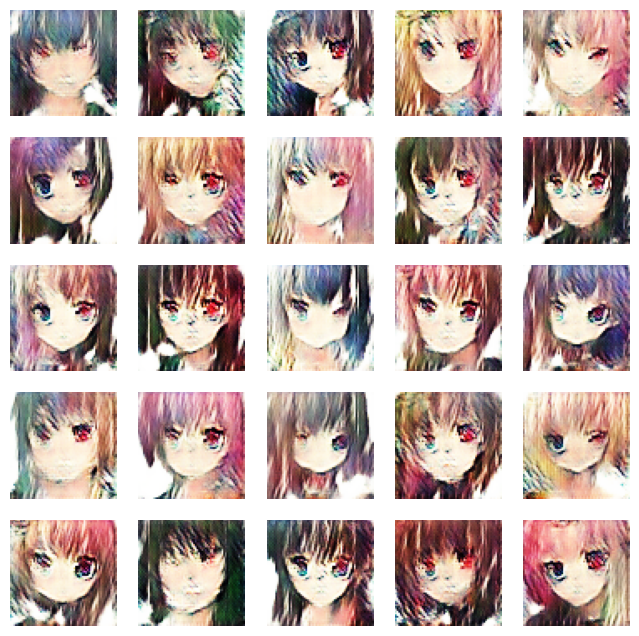

674/674 [==============================] - 28s 42ms/step - d_loss: 0.5845 - g_loss: 1.3683
Epoch 11/50
674/674 [==============================] - ETA: 0s - d_loss: 0.5998 - g_loss: 1.3030

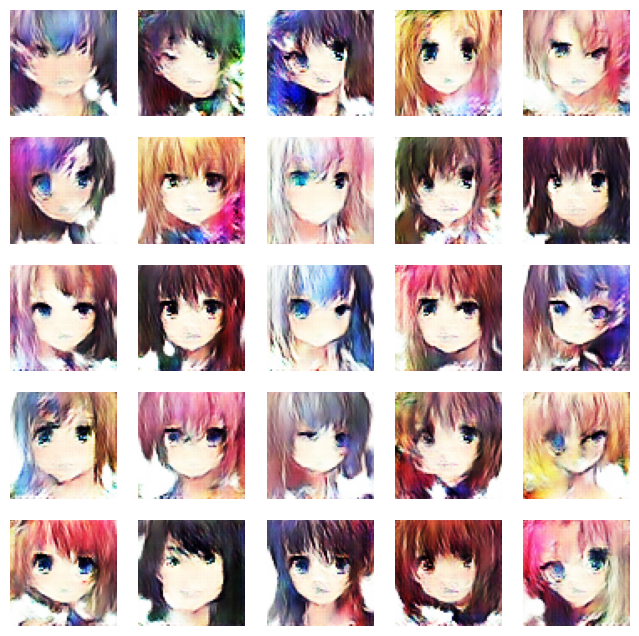

674/674 [==============================] - 28s 42ms/step - d_loss: 0.5998 - g_loss: 1.3030
Epoch 12/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6558 - g_loss: 1.1071

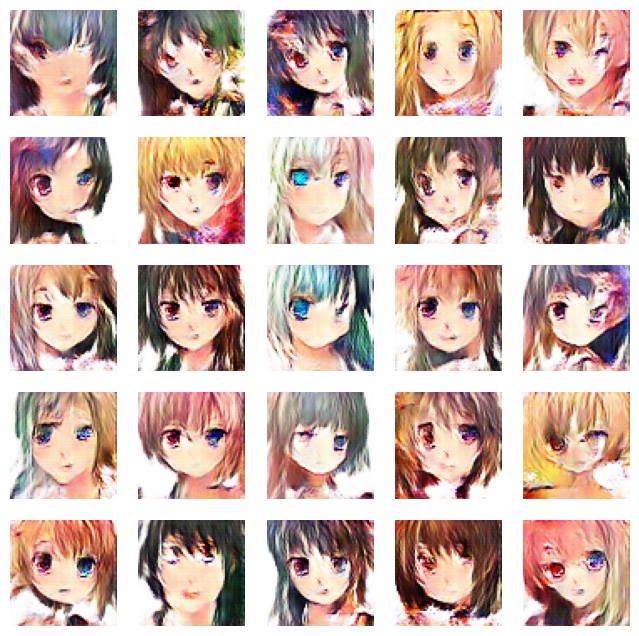

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6558 - g_loss: 1.1068
Epoch 13/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6637 - g_loss: 1.0427

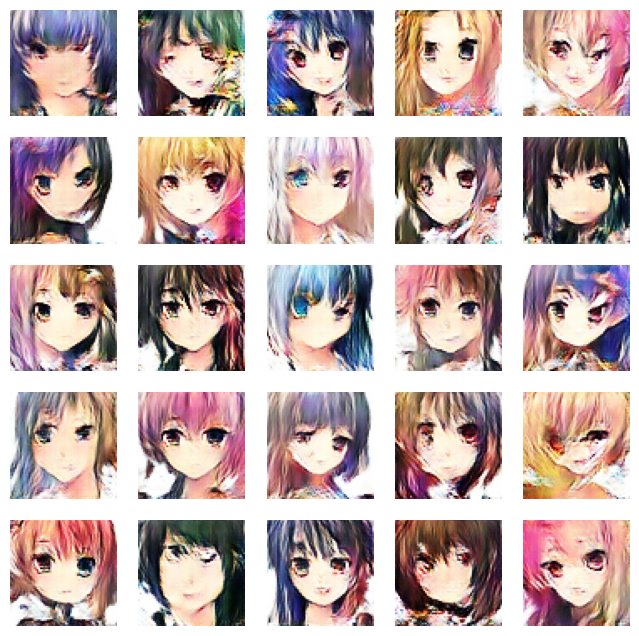

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6636 - g_loss: 1.0426
Epoch 14/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6771 - g_loss: 0.9823

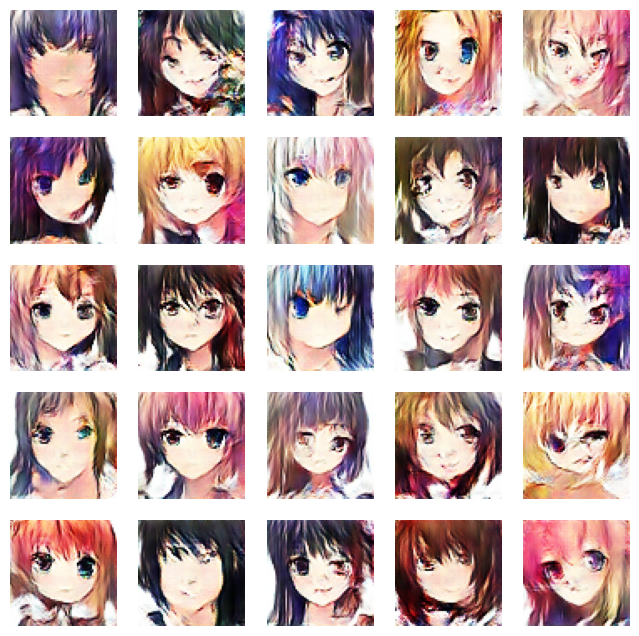

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6771 - g_loss: 0.9823
Epoch 15/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6807 - g_loss: 0.9474

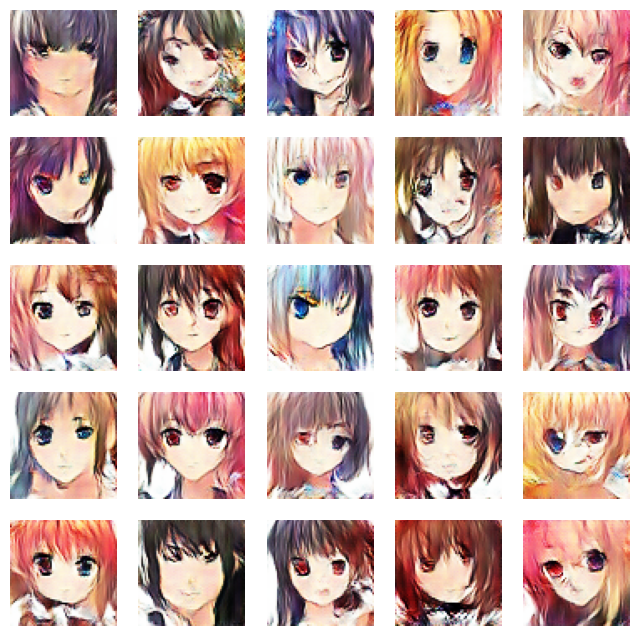

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6807 - g_loss: 0.9474
Epoch 16/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6824 - g_loss: 0.9306

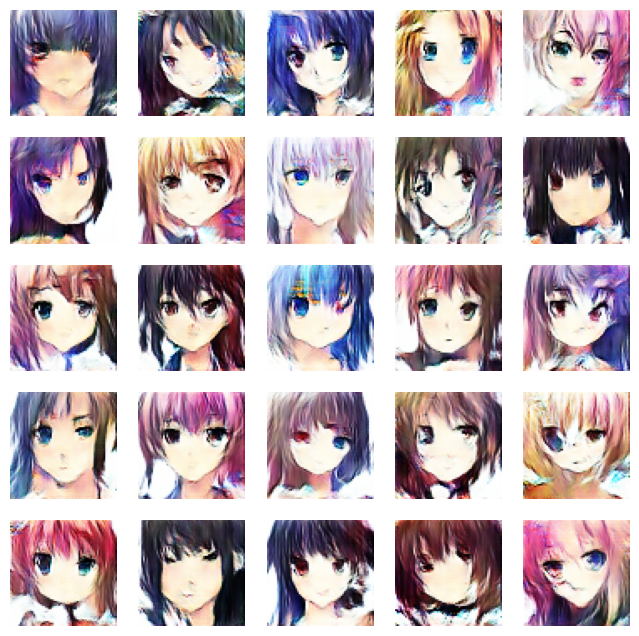

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6823 - g_loss: 0.9303
Epoch 17/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6864 - g_loss: 0.9058

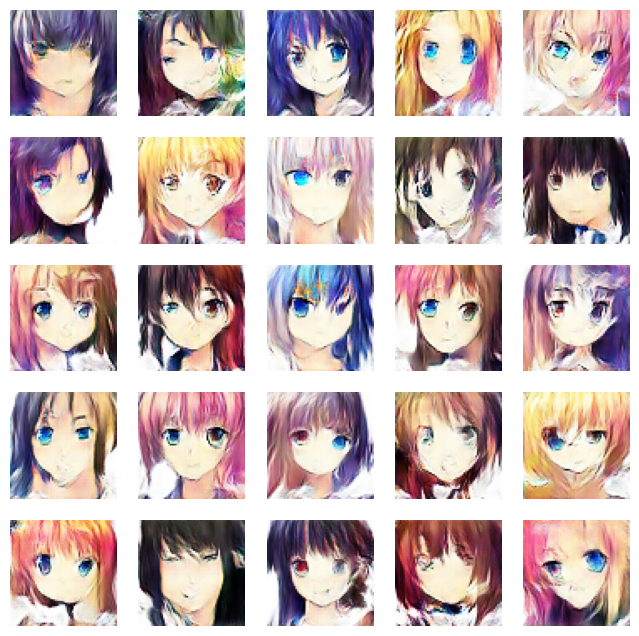

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6863 - g_loss: 0.9054
Epoch 18/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6883 - g_loss: 0.8794

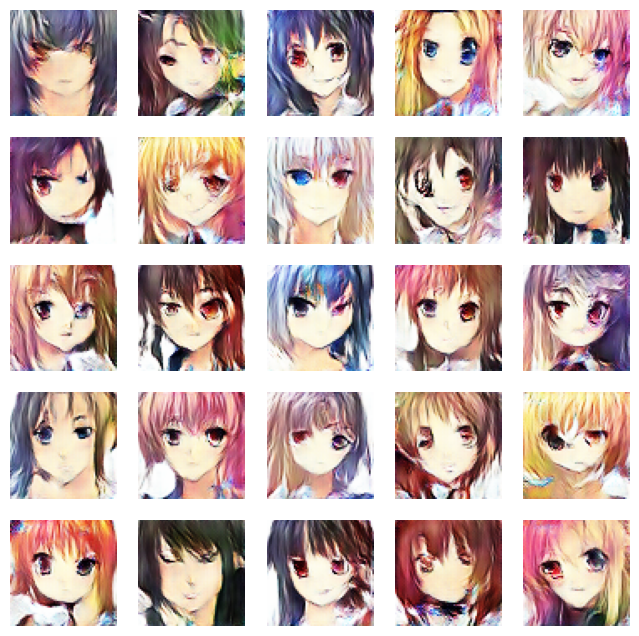

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6883 - g_loss: 0.8794
Epoch 19/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6887 - g_loss: 0.8758

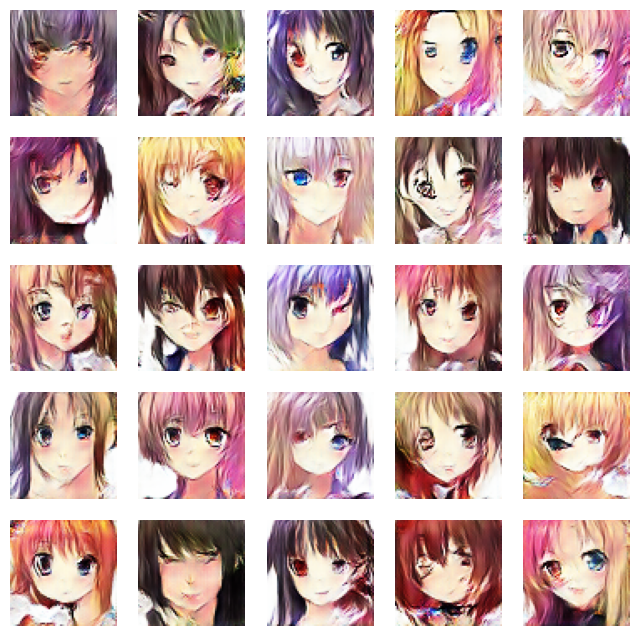

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6887 - g_loss: 0.8759
Epoch 20/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6841 - g_loss: 0.8599

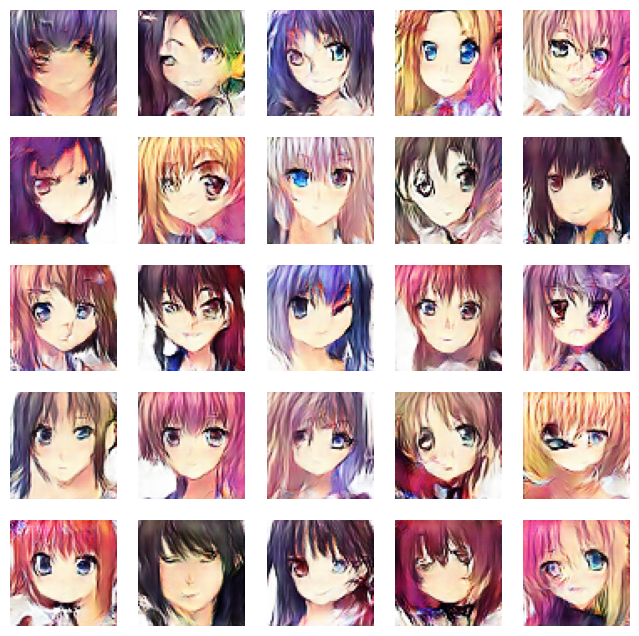

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6841 - g_loss: 0.8599
Epoch 21/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6821 - g_loss: 0.8559

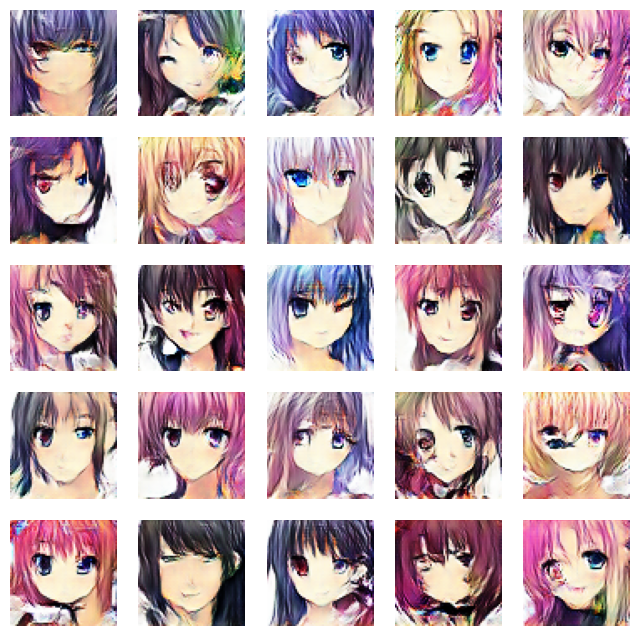

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6821 - g_loss: 0.8559
Epoch 22/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6811 - g_loss: 0.8598

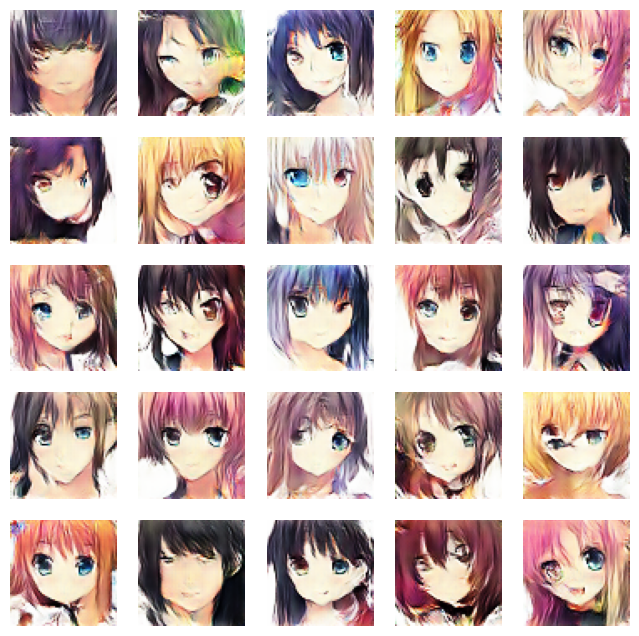

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6811 - g_loss: 0.8598
Epoch 23/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6772 - g_loss: 0.8601

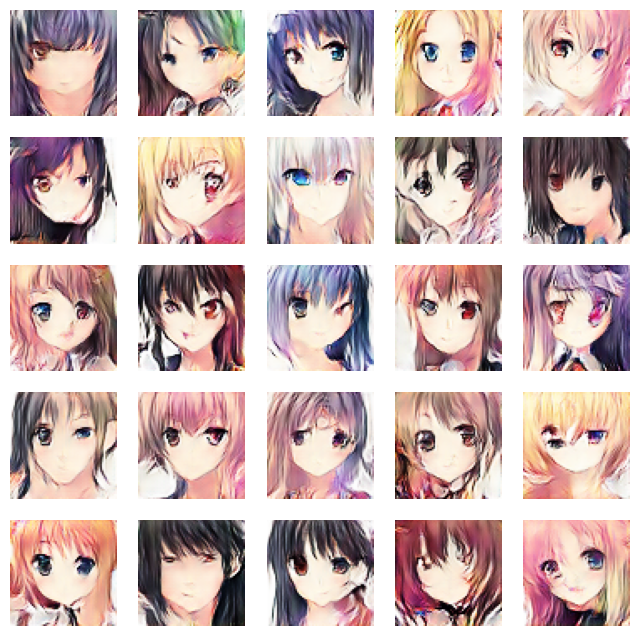

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6772 - g_loss: 0.8599
Epoch 24/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6758 - g_loss: 0.8602

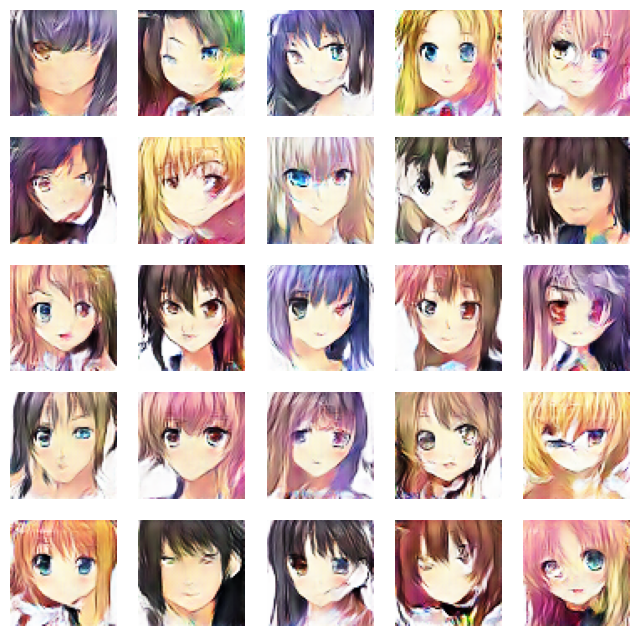

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6758 - g_loss: 0.8603
Epoch 25/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6708 - g_loss: 0.8641

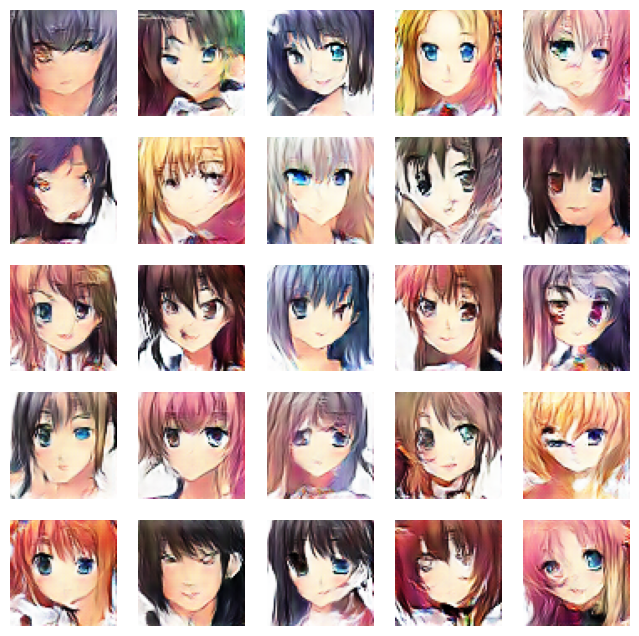

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6708 - g_loss: 0.8641
Epoch 26/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6681 - g_loss: 0.8690

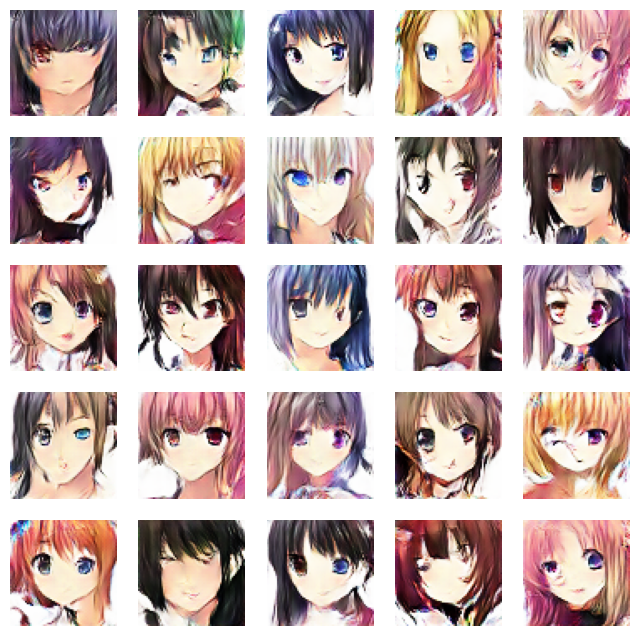

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6681 - g_loss: 0.8690
Epoch 27/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6649 - g_loss: 0.8863

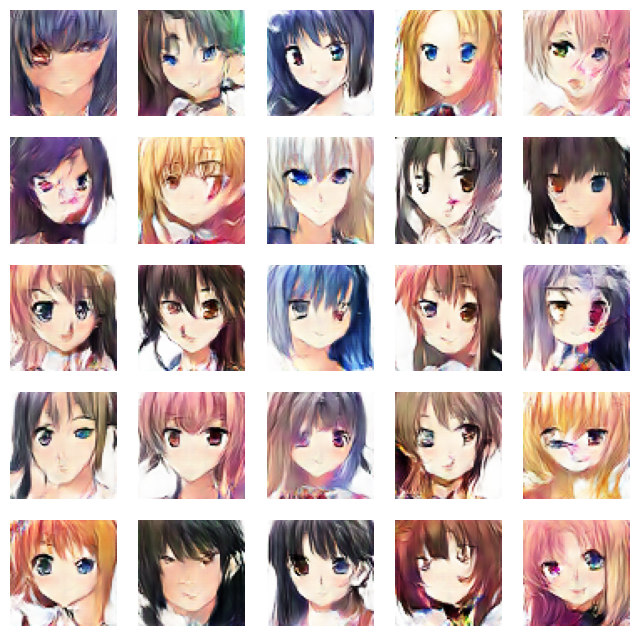

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6649 - g_loss: 0.8863
Epoch 28/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6595 - g_loss: 0.8863

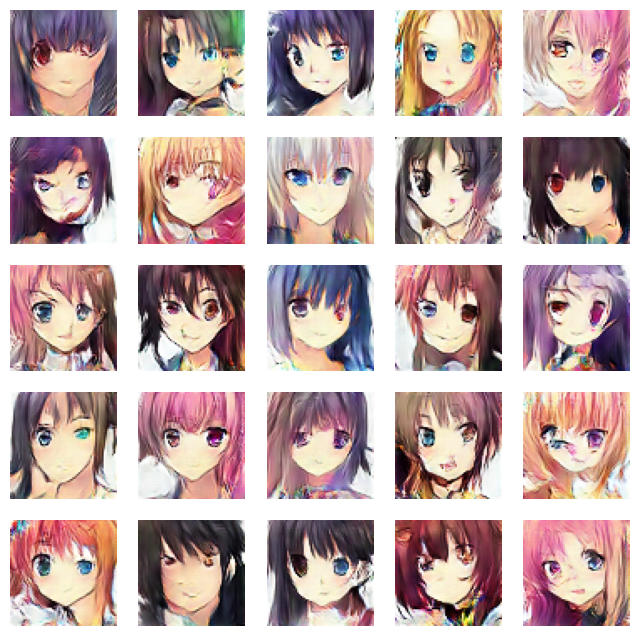

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6595 - g_loss: 0.8863
Epoch 29/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6575 - g_loss: 0.8993

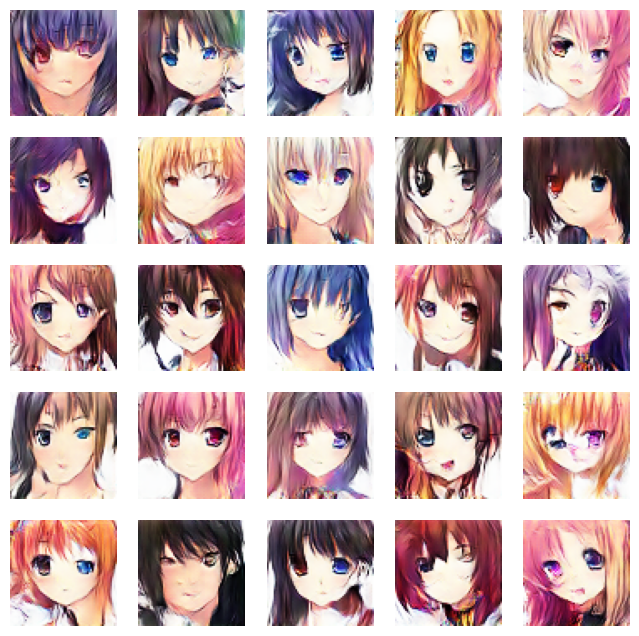

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6575 - g_loss: 0.8993
Epoch 30/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6504 - g_loss: 0.9072

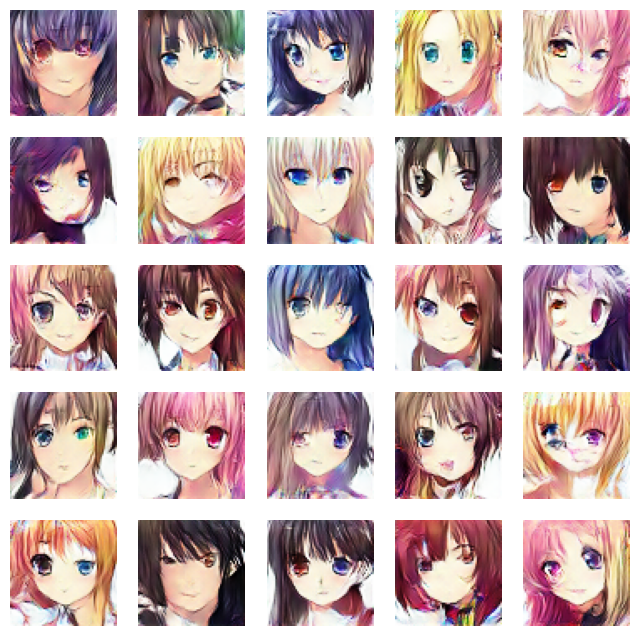

674/674 [==============================] - 29s 42ms/step - d_loss: 0.6504 - g_loss: 0.9072
Epoch 31/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6497 - g_loss: 0.9185

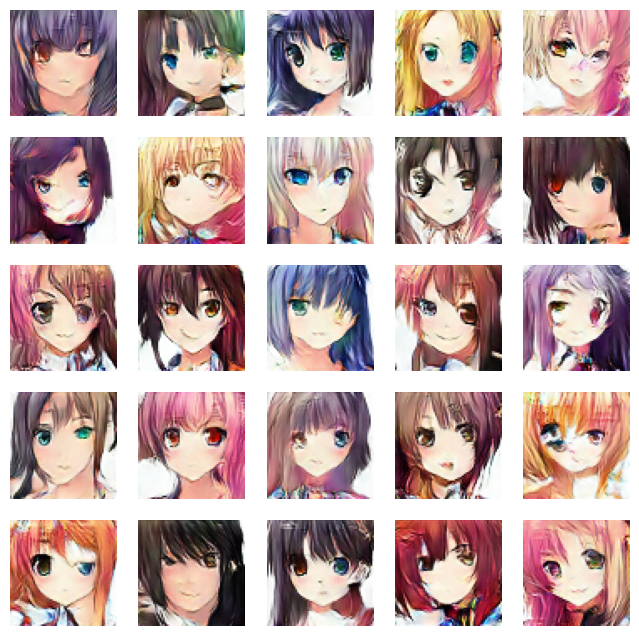

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6497 - g_loss: 0.9185
Epoch 32/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6446 - g_loss: 0.9289

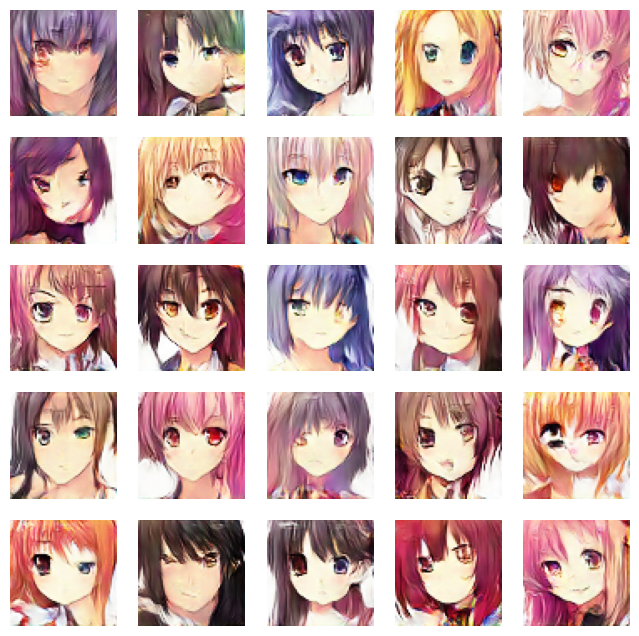

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6446 - g_loss: 0.9288
Epoch 33/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6443 - g_loss: 0.9365

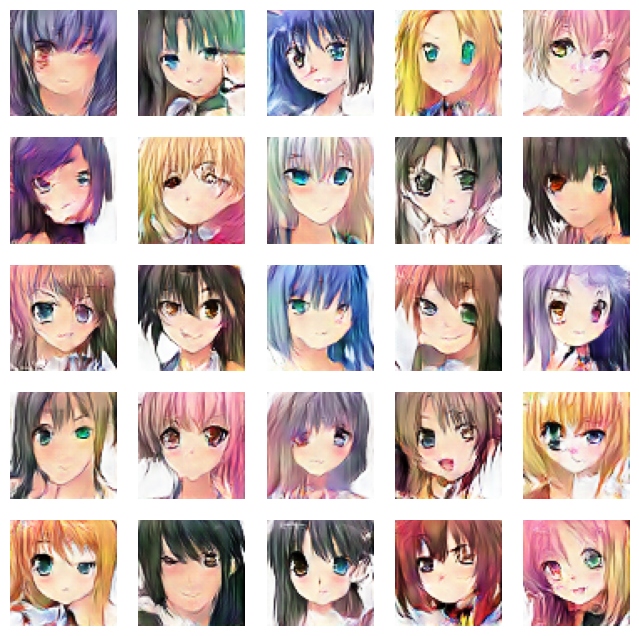

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6443 - g_loss: 0.9365
Epoch 34/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6402 - g_loss: 0.9462

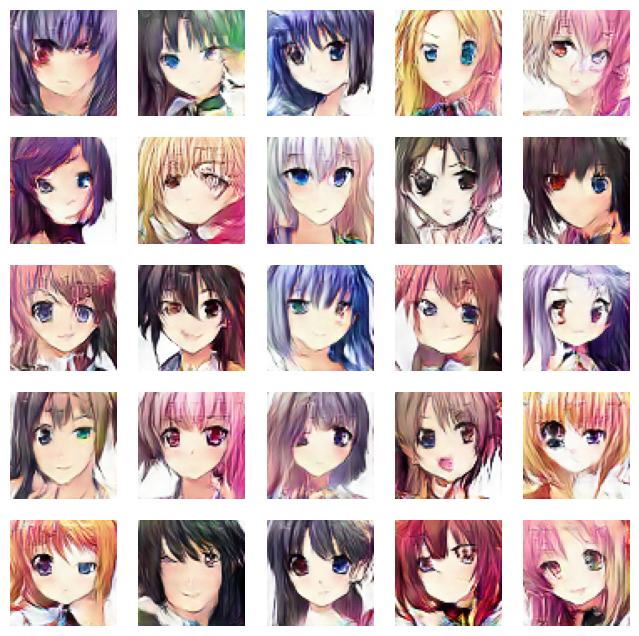

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6401 - g_loss: 0.9463
Epoch 35/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6375 - g_loss: 0.9501

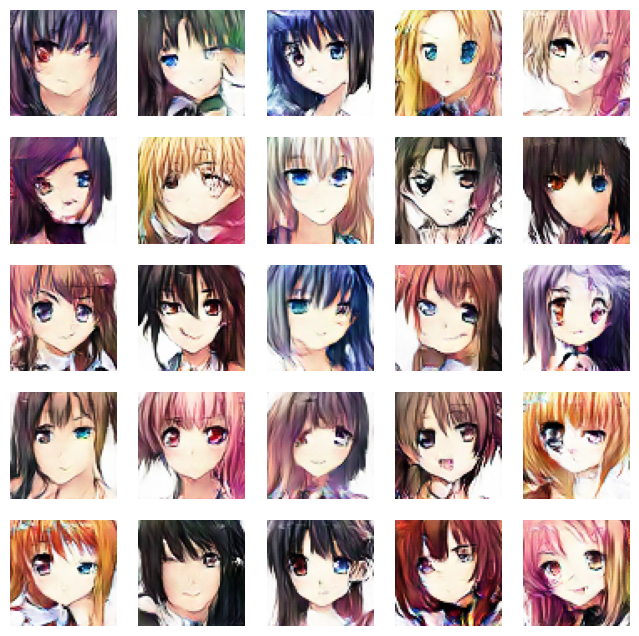

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6375 - g_loss: 0.9501
Epoch 36/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6315 - g_loss: 0.9599

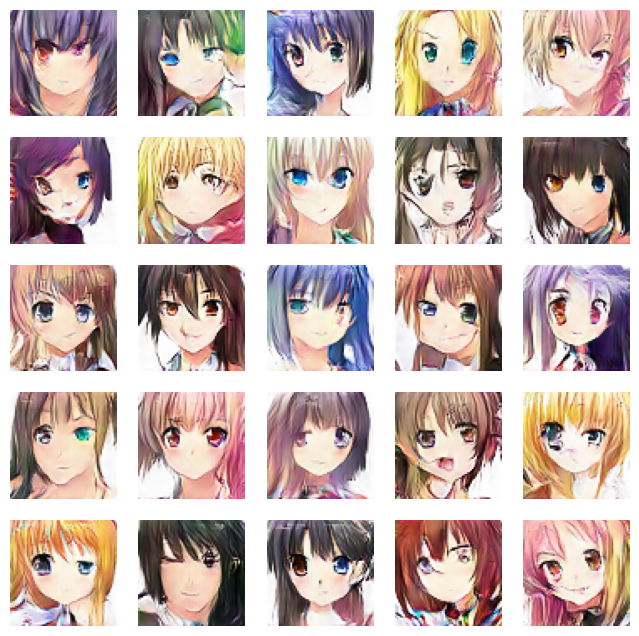

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6315 - g_loss: 0.9599
Epoch 37/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6261 - g_loss: 0.9712

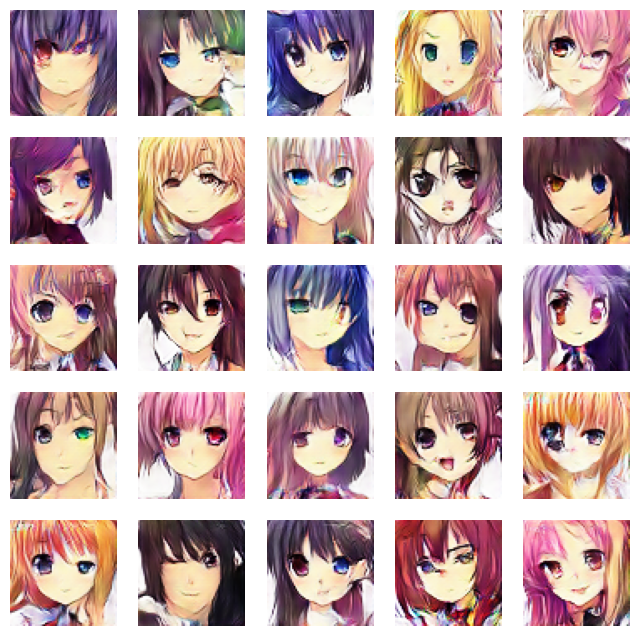

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6261 - g_loss: 0.9712
Epoch 38/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6236 - g_loss: 0.9879

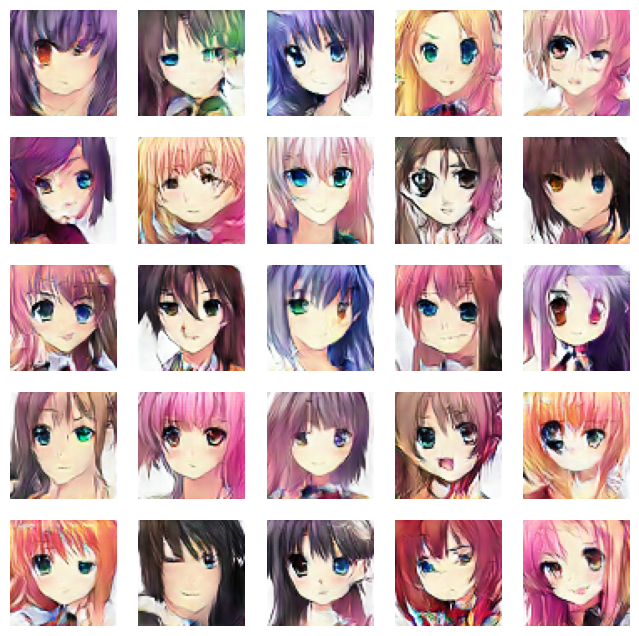

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6235 - g_loss: 0.9880
Epoch 39/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6201 - g_loss: 0.9974

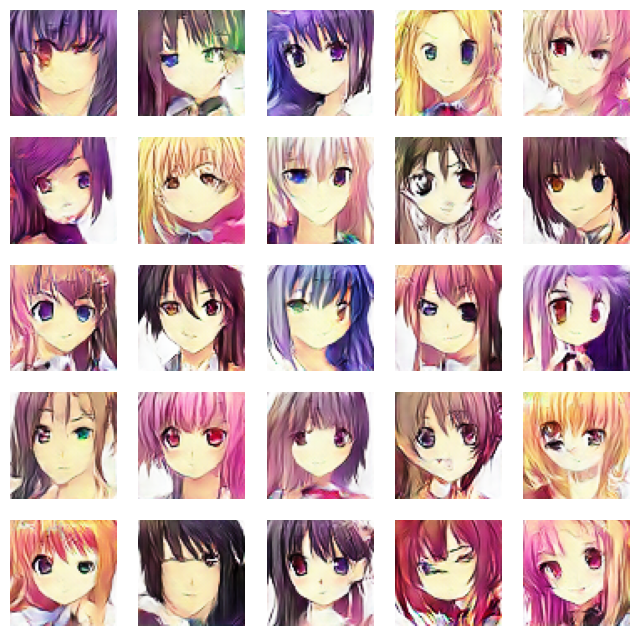

674/674 [==============================] - 29s 42ms/step - d_loss: 0.6203 - g_loss: 0.9978
Epoch 40/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6152 - g_loss: 1.0090

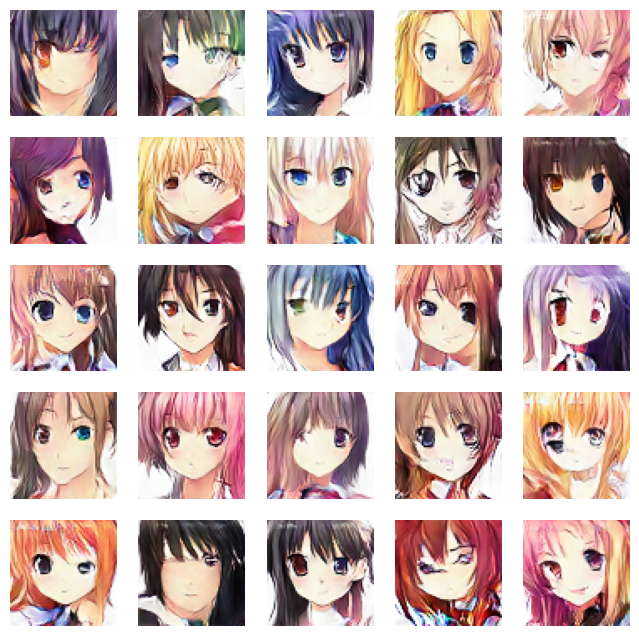

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6151 - g_loss: 1.0091
Epoch 41/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6094 - g_loss: 1.0256

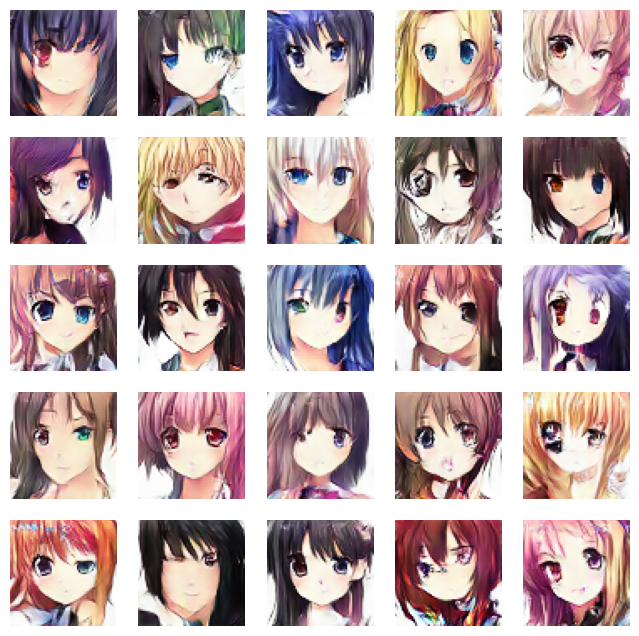

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6093 - g_loss: 1.0258
Epoch 42/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6067 - g_loss: 1.0443

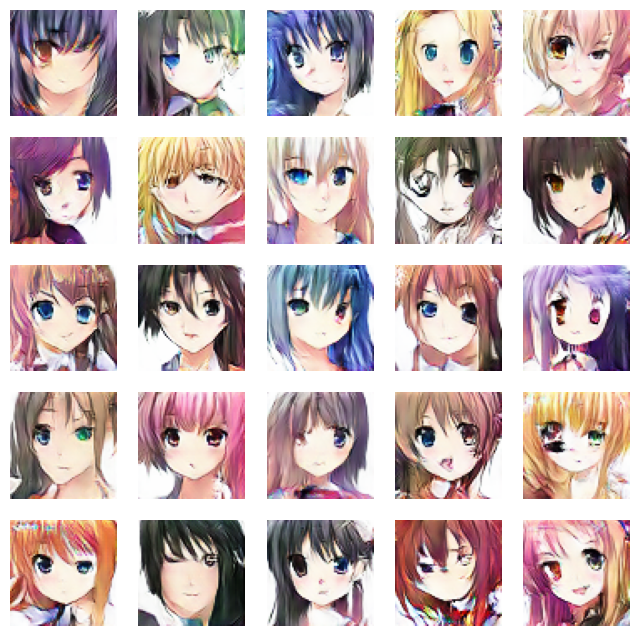

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6066 - g_loss: 1.0441
Epoch 43/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6044 - g_loss: 1.0540

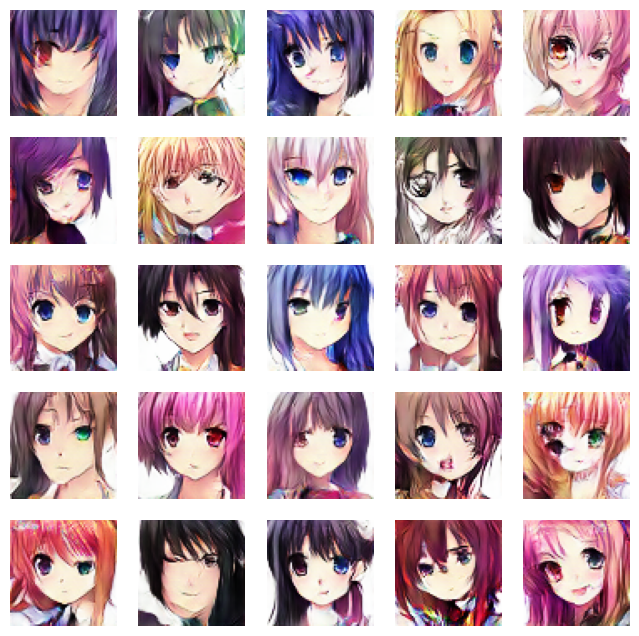

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6045 - g_loss: 1.0541
Epoch 44/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6010 - g_loss: 1.0655

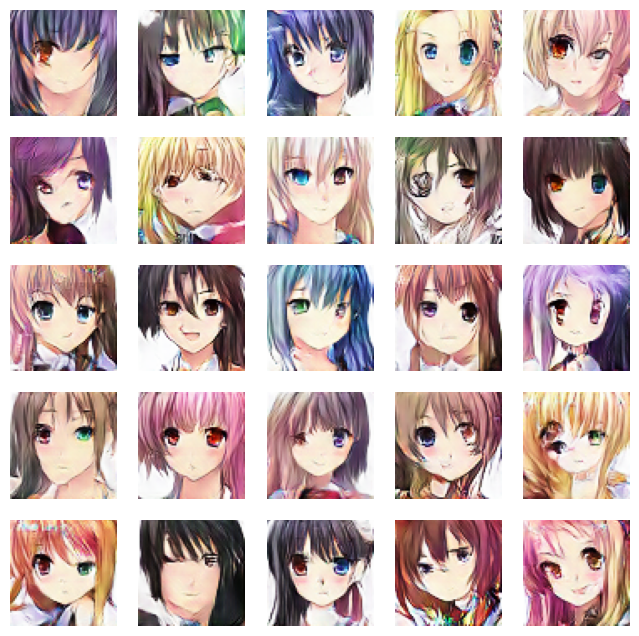

674/674 [==============================] - 28s 42ms/step - d_loss: 0.6008 - g_loss: 1.0654
Epoch 45/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6018 - g_loss: 1.0713

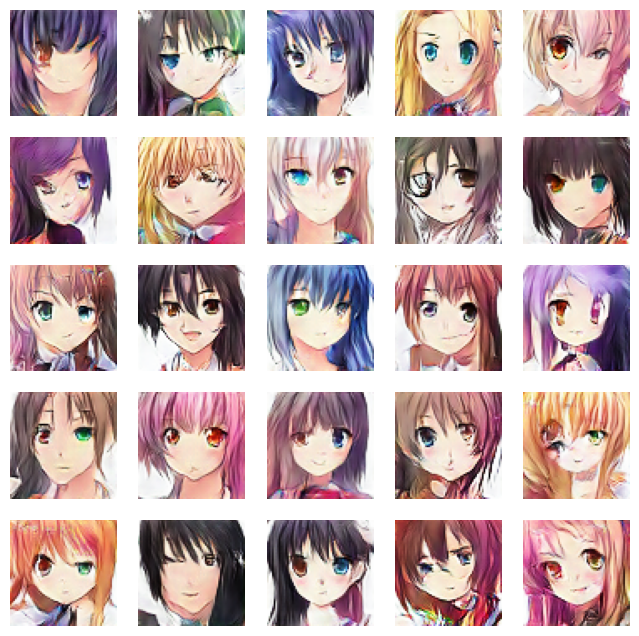

674/674 [==============================] - 29s 43ms/step - d_loss: 0.6018 - g_loss: 1.0713
Epoch 46/50
674/674 [==============================] - ETA: 0s - d_loss: 0.5927 - g_loss: 1.0792

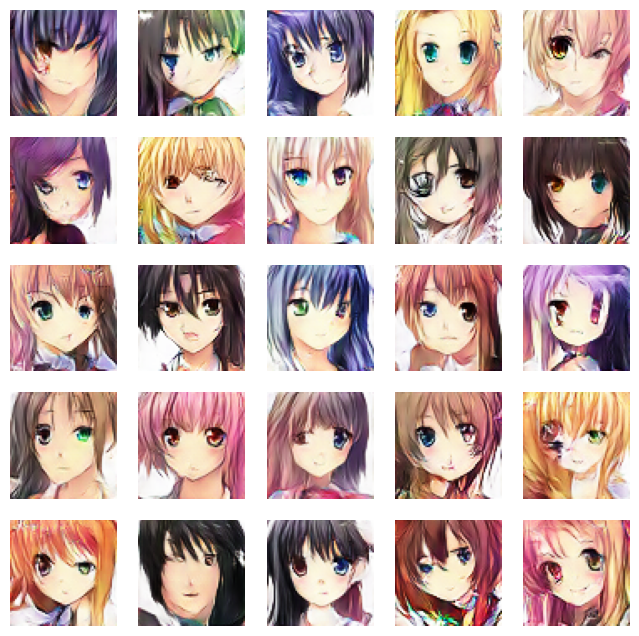

674/674 [==============================] - 28s 42ms/step - d_loss: 0.5927 - g_loss: 1.0792
Epoch 47/50
674/674 [==============================] - ETA: 0s - d_loss: 0.5919 - g_loss: 1.0975

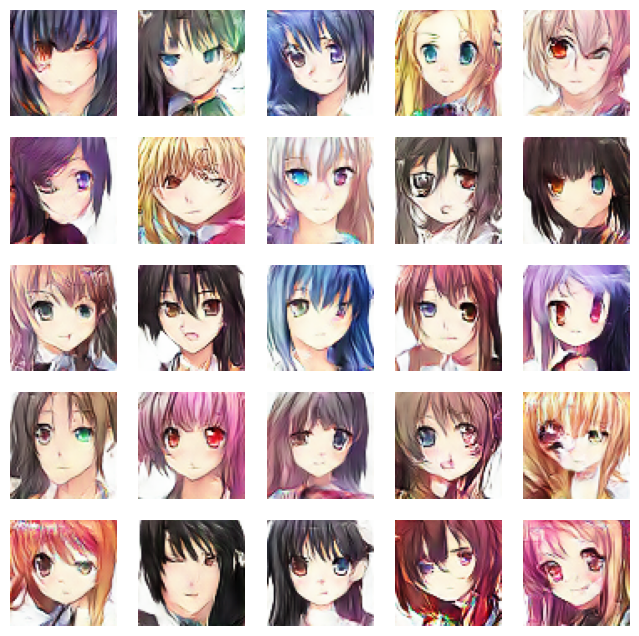

674/674 [==============================] - 29s 43ms/step - d_loss: 0.5919 - g_loss: 1.0975
Epoch 48/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5895 - g_loss: 1.1117

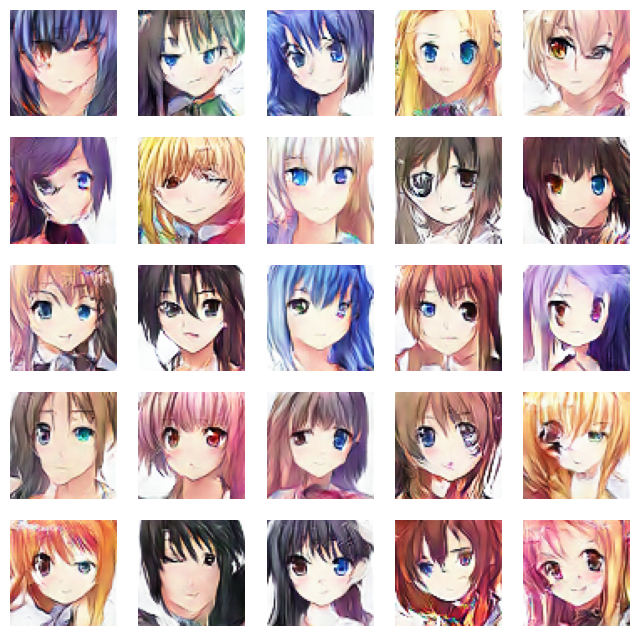

674/674 [==============================] - 29s 42ms/step - d_loss: 0.5895 - g_loss: 1.1117
Epoch 49/50
674/674 [==============================] - ETA: 0s - d_loss: 0.5844 - g_loss: 1.1305

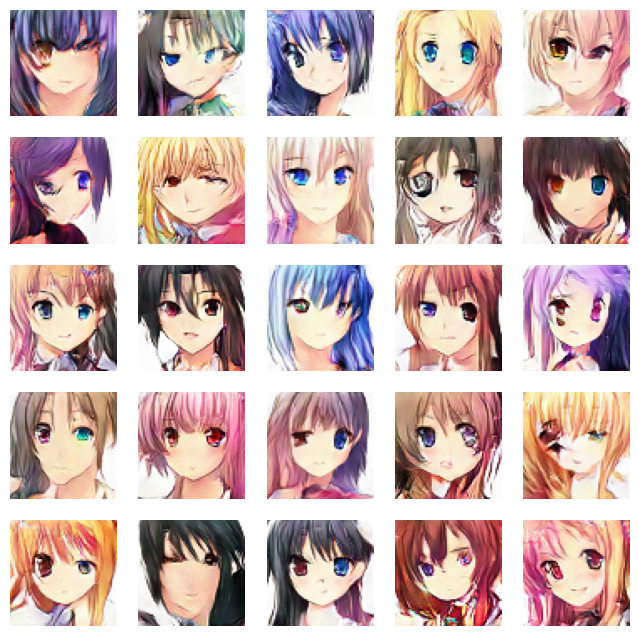

674/674 [==============================] - 28s 42ms/step - d_loss: 0.5844 - g_loss: 1.1305
Epoch 50/50
674/674 [==============================] - ETA: 0s - d_loss: 0.5829 - g_loss: 1.1311

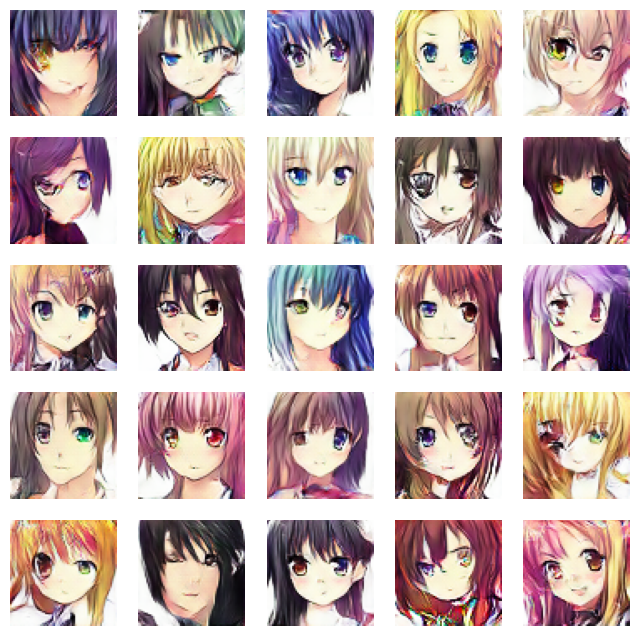

674/674 [==============================] - 28s 42ms/step - d_loss: 0.5829 - g_loss: 1.1311


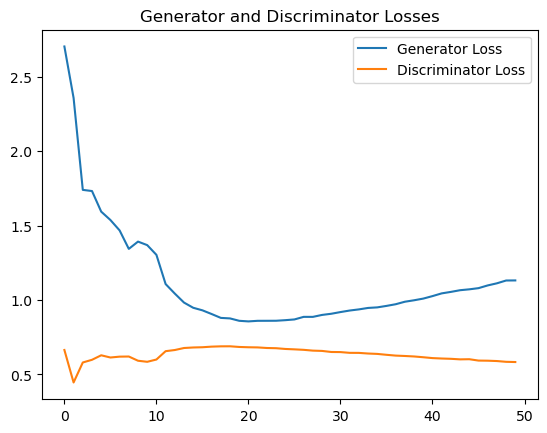

In [19]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

## Generate new anime face image after training, include noise

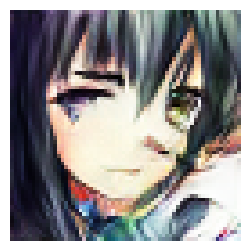

In [20]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
# plt.savefig('epoch_{:03d}.png'.format(epoch))
plt.show()

## Zip file 500 images

In [21]:
import tensorflow as tf
import matplotlib.pyplot as plt
import zipfile
def generate_and_save_images(model, output_dir, num_images):
    # Create output directory if it doesn't exist
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    for i in range(num_images):
        # Generate noise
        noise = tf.random.normal([1, 100])
        
        # Generate image from noise
        g_img = model.generator(noise)
        
        # Denormalize the image
        g_img = (g_img * 127.5) + 127.5
        
        # Convert image to PIL Image
        img = array_to_img(g_img[0])
        
        # Save image
        img.save(os.path.join(output_dir, 'image_{:03d}.png'.format(i)))

    # Create a zip file
    with zipfile.ZipFile('output.zip', 'w') as zipf:
        # Add images to the zip file
        for i in range(num_images):
            zipf.write(os.path.join(output_dir, 'image_{:03d}.png'.format(i)), 'image_{:03d}.png'.format(i))


In [22]:
output_dir = 'output_images'
num_images = 500

generate_and_save_images(dcgan, output_dir, num_images)


## Make folder include 500 images

In [23]:
import os
import tensorflow as tf
import matplotlib.pyplot as plt

def generate_and_save_images(model, output_dir, num_images):
    # Create output directory if it doesn't exist
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    for i in range(num_images):
        # Generate noise
        noise = tf.random.normal([1, 100])
        
        # Generate image from noise
        g_img = model.generator(noise)
        
        # Denormalize the image
        g_img = (g_img * 127.5) + 127.5
        
        # Convert image to PIL Image
        img = array_to_img(g_img[0])
        
        # Save image
        img.save(os.path.join(output_dir, 'image_{:03d}.png'.format(i)))

output_dir = 'output_images'
num_images = 500

generate_and_save_images(dcgan, output_dir, num_images)


## Calculate accuracy of real image and fake image

In [24]:
def compute_accuracy(discriminator, real_image_dir, fake_image_dir):
    # Load real images from the directory
    real_images = []
    for filename in os.listdir(real_image_dir):
        img = tf.keras.preprocessing.image.load_img(os.path.join(real_image_dir, filename))
        img = tf.keras.preprocessing.image.img_to_array(img)
        real_images.append(img)
    real_images = tf.convert_to_tensor(real_images)

    # Generate fake images
    random_noise = tf.random.normal(shape=(real_images.shape[0], 100))
    fake_images = generator(random_noise)

    # Predict labels for real and fake images
    real_predictions = discriminator(real_images)
    fake_predictions = discriminator(fake_images)

    # Calculate accuracy for real images
    real_accuracy = tf.reduce_mean(tf.cast(real_predictions >= 0.5, tf.float32))

    # Calculate accuracy for fake images
    fake_accuracy = tf.reduce_mean(tf.cast(fake_predictions < 0.5, tf.float32))

    return real_accuracy, fake_accuracy

real_image_dir = 'output_images'
fake_image_dir = 'output_images'
real_accuracy, fake_accuracy = compute_accuracy(discriminator, real_image_dir, fake_image_dir)
print('Real Image Accuracy:', real_accuracy.numpy())
print('Fake Image Accuracy:', fake_accuracy.numpy())


Real Image Accuracy: 1.0
Fake Image Accuracy: 0.386
